<a href="https://colab.research.google.com/github/mandraa/MachineLearning/blob/main/Kuis2_MachineLearning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Kuis 2 Machine Learning**
***


# **Kuis Tesseract OCR**

Membuat program OCR untuk mengekstrak text dari data ktp, dengan input foto ktp dan output text.

**Menghubungkan ke google drive**

In [18]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


**Instalasi dan Import Library**

In [19]:
!sudo apt install tesseract-ocr
!pip install pytesseract
!pip install opencv-python

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 15 not upgraded.


In [20]:
import re
import cv2
import numpy as np
import pytesseract
from pytesseract import Output
from matplotlib import pyplot as plt

**Membuat fungsi Pemrosesan Gambar**

In [21]:
def process_image(image_path):
    # Membaca gambar dari direktori
    image = cv2.imread(image_path)

    # Memisahkan saluran warna (blue, green, red) karena matplotlib menggunakan skema warna RGB
    b, g, r = cv2.split(image)
    rgb_img = cv2.merge([r, g, b])

    # Menampilkan gambar dalam ukuran tertentu
    plt.figure(figsize=(16, 12))
    plt.imshow(rgb_img)
    plt.title('Gambar Teks')
    plt.show()

    plt.figure(figsize=(16, 12))
    plt.imshow(image)
    plt.title('Gambar Teks')
    plt.show()

    # Proses teks menggunakan pytesseract
    text = pytesseract.image_to_string(image)
    print("Text extracted:")
    print(text)

    # Bounding box
    d = pytesseract.image_to_data(image, output_type=Output.DICT)
    n_boxes = len(d['level'])
    for i in range(n_boxes):
        (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    # Menampilkan gambar dengan bounding box
    plt.figure(figsize=(16, 12))
    plt.imshow(image)
    plt.title('Gambar dengan Bounding Box')
    plt.show()

**Menentukan path gambar dan memanggil fungsi**

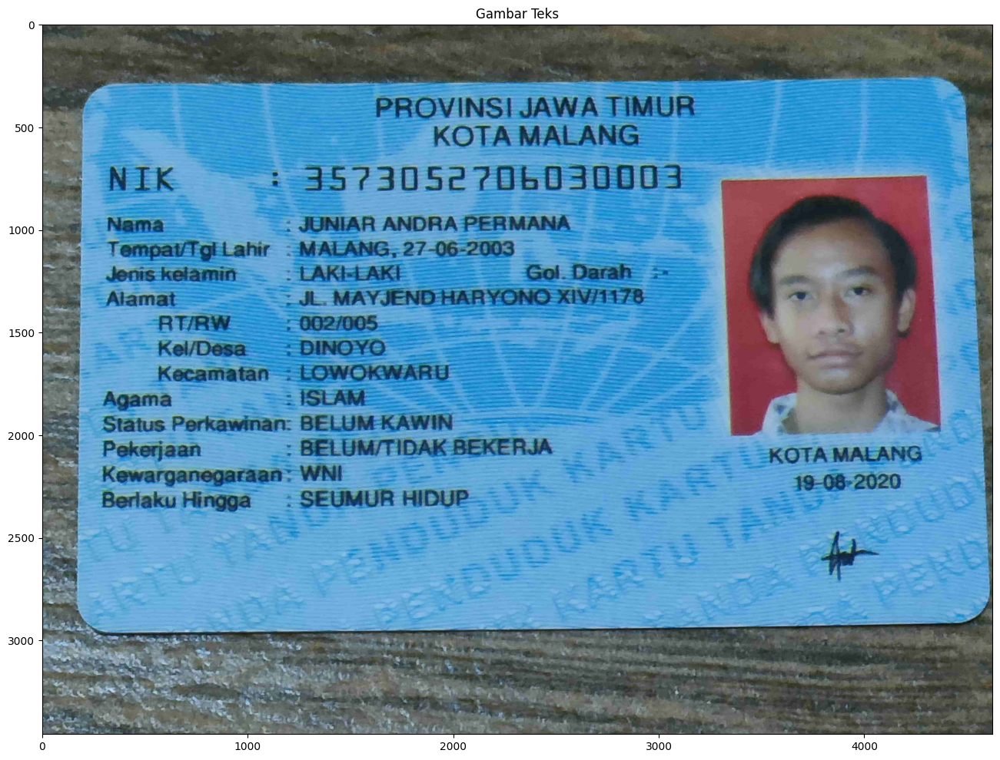

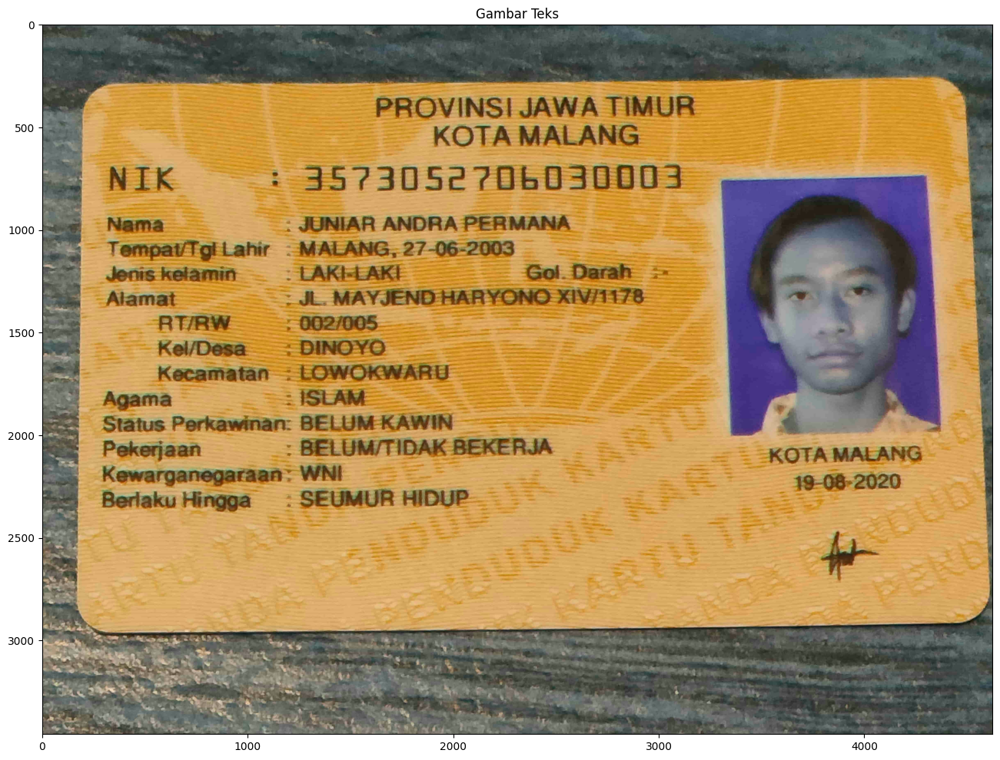

Text extracted:
PROVINS| JAWA TIMUR
KOTA MALANG

NIK 3573052 706030004
Nama : JUNIAR ANDRA PERMANA

~e rota _-MALANG,, 27-06-2003

 

Aiamat MAYJEND HARYO
RTURW
Kel/Desa_
Kecamatan
Agama

eee qt!
; eee aeTEL

bio bb

Status Perkawinan: BELUM KAWIN- =
Pekerjaan : BELUM/TIDAK BEKERJA
Kewarganegaraan: WNI

Berlaku Hingga —s- SEUMUR HIDUP

Stes a we mi

oo ee



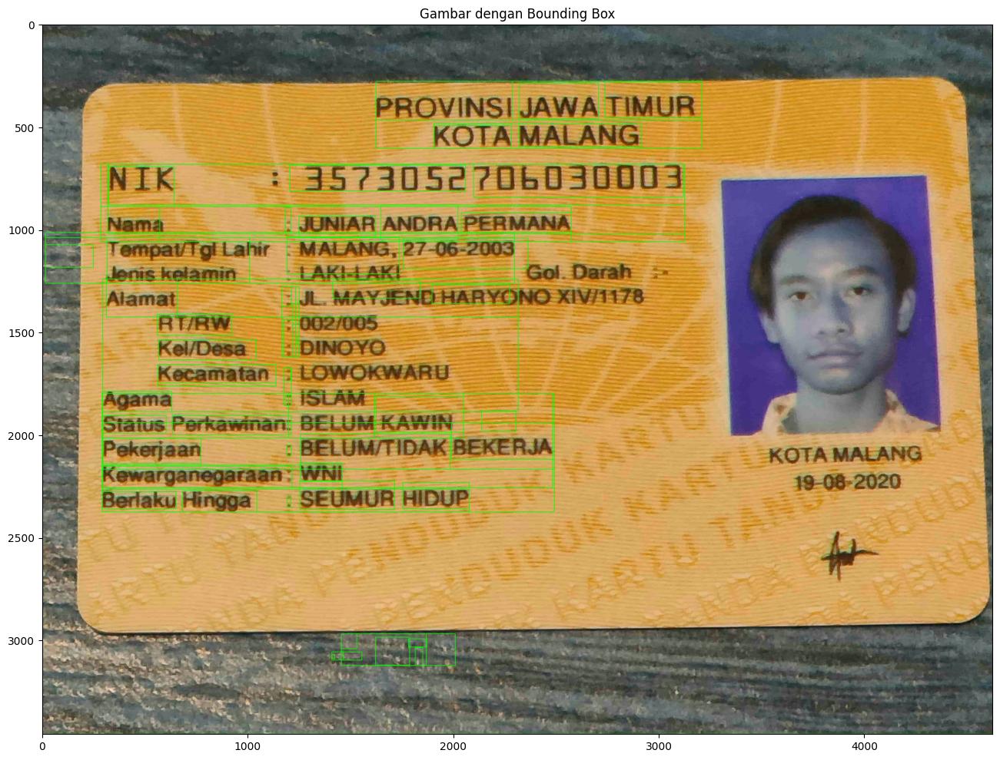

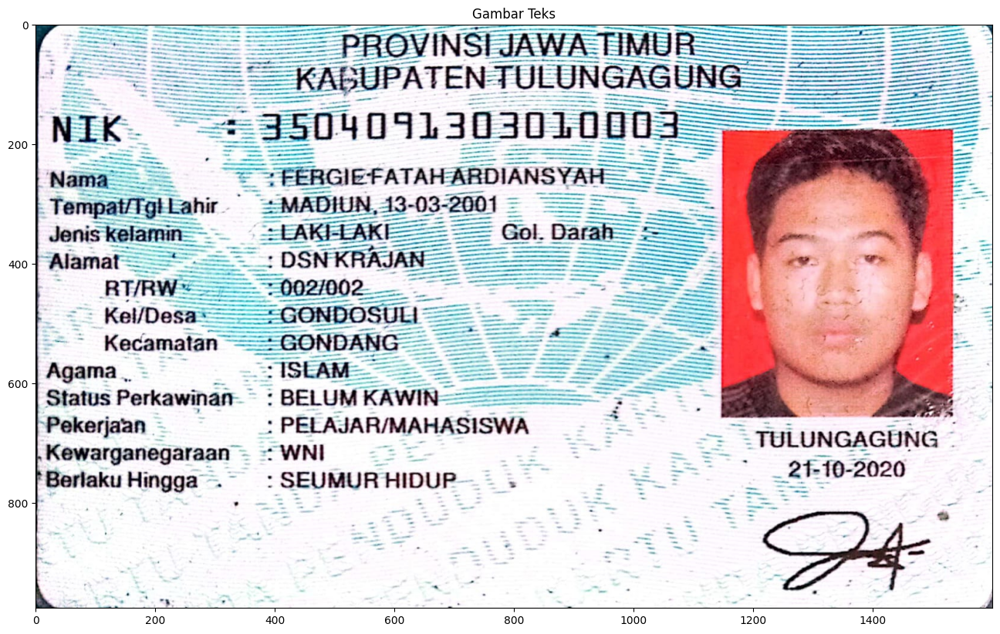

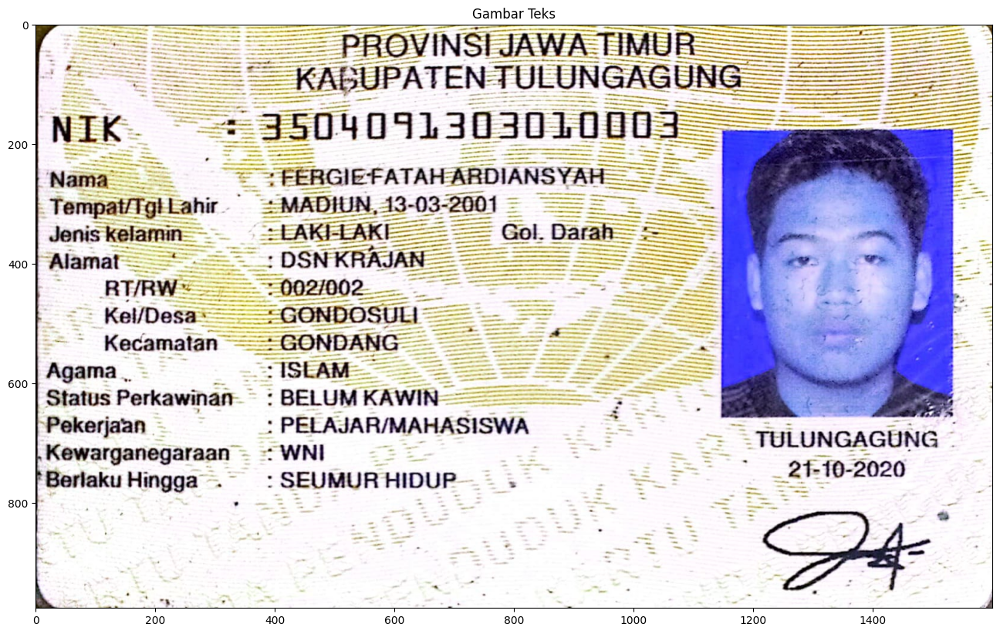

Text extracted:
allt

  

Status Perkawinan- = - : f
~Pekerjaan ~ : PELAJAR/MAHASISWA ~~ Tul
Kewarganegaraan — = WNI Se. SS ae
BerlakuHingga .- :SEUMURHIDUP-— - = ——

   



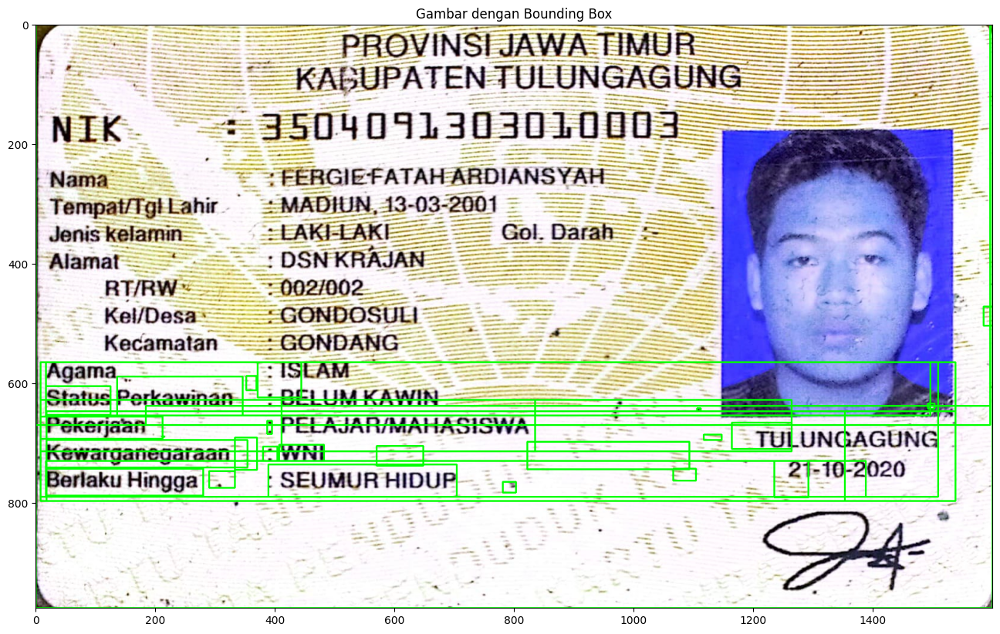

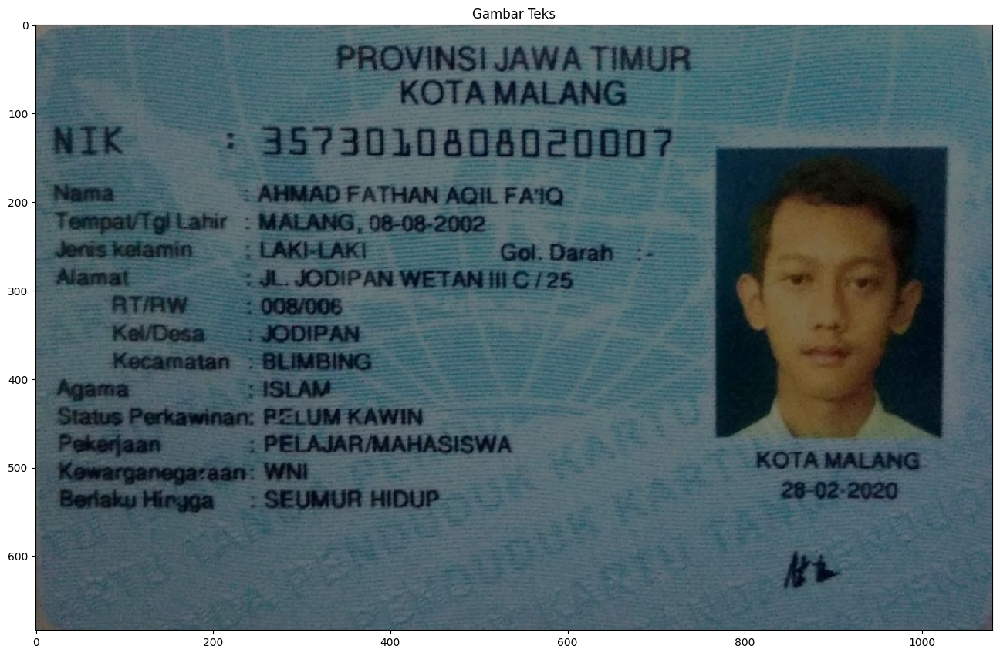

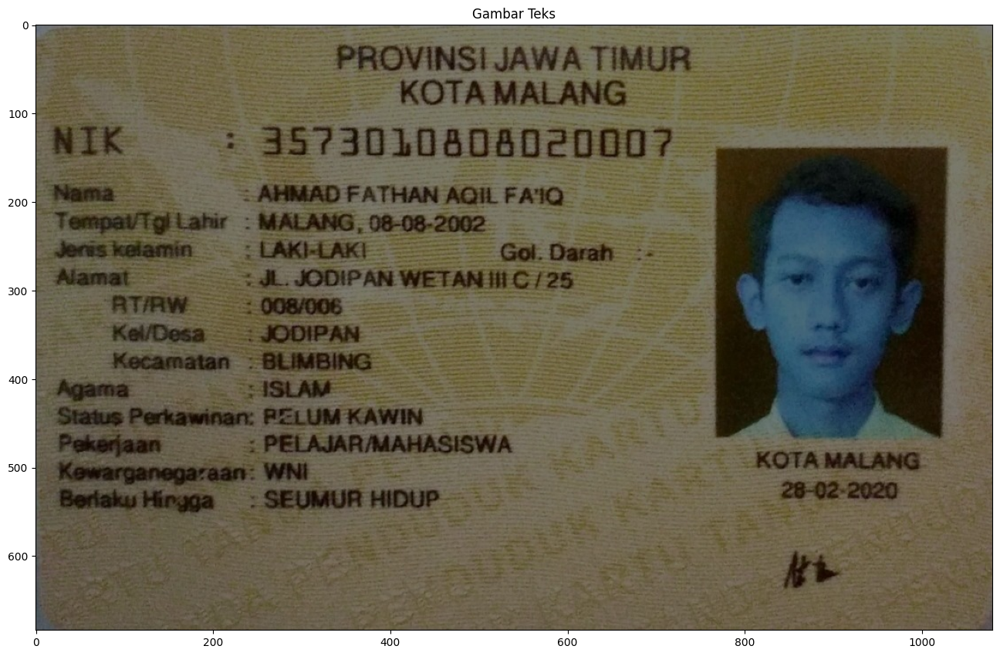

Text extracted:
PROVINS! JAWA TIMUR

KOTA MALANG
NIK : * 35730108080e0007
Nama - AHMAD FATHAN AQIL FAQ
Tempat/TgiLahir - MALANG, 06-08-2002

Jeris kelamin : LAKI-LAKI Gol.
Alamat =k JODIPAN WETAN III /25

 

Kecamatan = =
==
5 ee KOTA MALANG

he



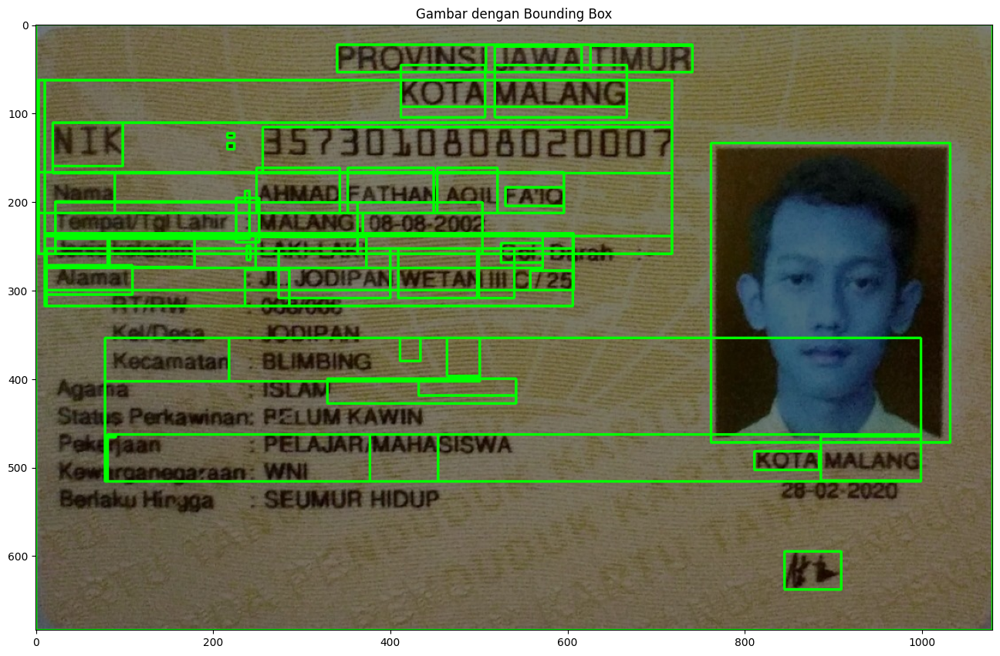

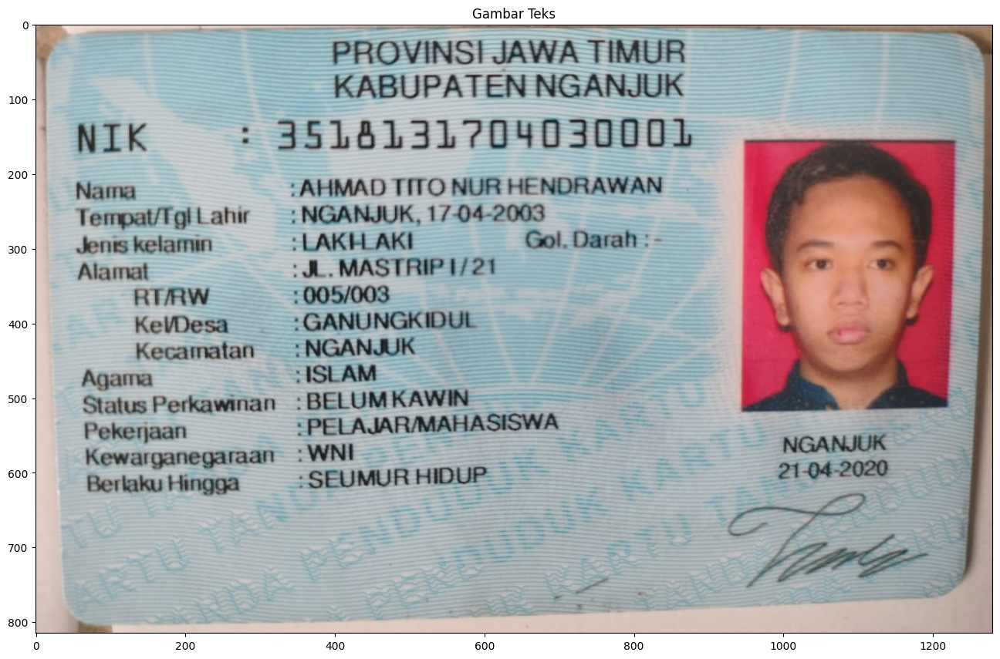

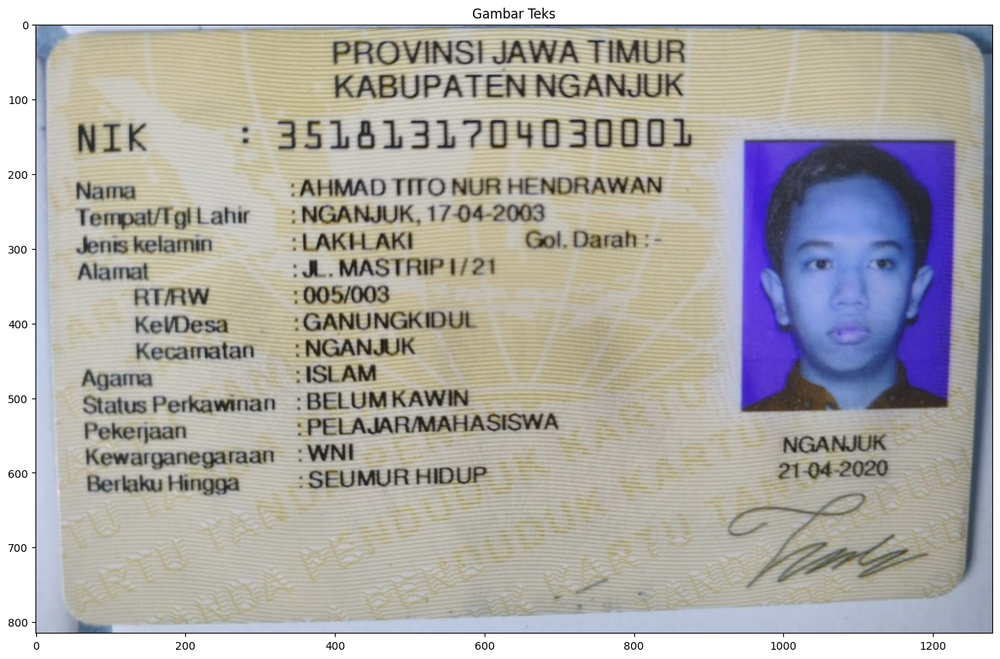

Text extracted:
   
 
 
     

~ PROVINSI JAWA TIMUR

__ KABUPATEN NGANJUK

NIK : 3514131704030001
Nama AHMAD TITO NUR HENDRAWAN
Tempat/TgiLahir —; NGANJUK, 17-04-2003
Jents kelarmin : LAKELAKI Gol. Darah : -
Alamat JL. MASTRIP 1/21

RTRW

KelDesa

Kecamatan
Agama :
Status Perkawinan :
Pekerjaan
Kewarganegaraan :
Berlaku Hingga



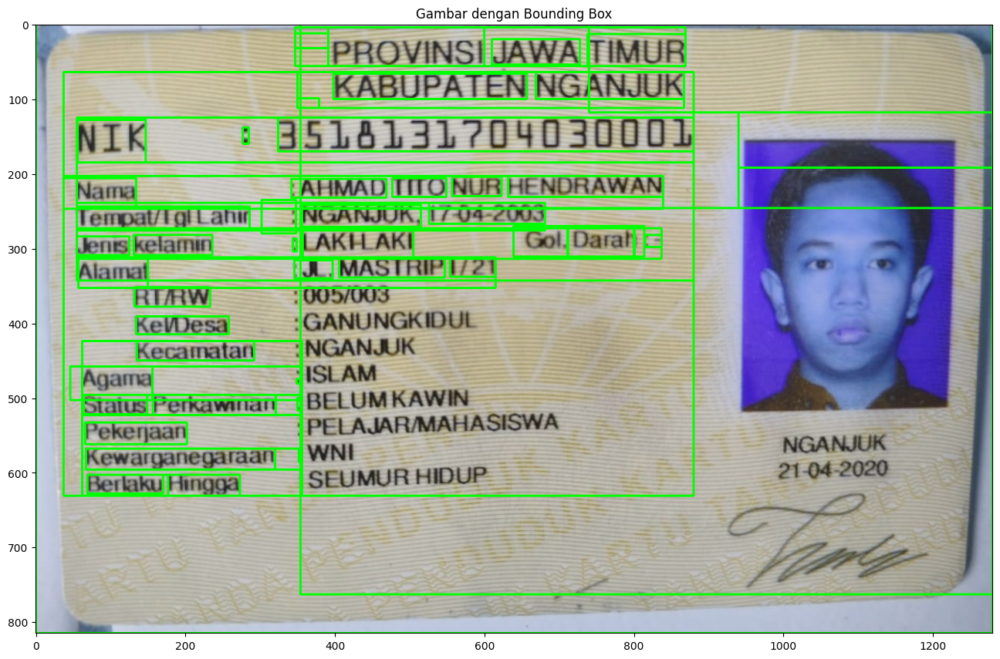

In [22]:
IMG_DIR = '/content/drive/MyDrive/ML'
process_image(IMG_DIR + '/KTP1.jpg')
process_image(IMG_DIR + '/KTP2.jpeg')
process_image(IMG_DIR + '/KTP3.jpeg')
process_image(IMG_DIR + '/KTP4.jpeg')